In [1]:
import pandas as pd
from gensim.models.phrases import Phraser, Phrases
from gensim.models.word2vec import Word2Vec
import nltk
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

%matplotlib inline

In [2]:
df = pd.read_csv('ready_df.csv')

# Word2Vec teory

In [3]:
wpt = nltk.WordPunctTokenizer()
tokenized_corpus = [wpt.tokenize(str(document)) for document in df.content[df.is_ru][df.as_tag]]

In [4]:
bigram = Phrases(tokenized_corpus)
bigram_transformer = Phraser(bigram)

In [5]:
def tex_gen_bigram(tokenized_corpus = tokenized_corpus):
    bigr = []
    for text in tokenized_corpus:
        bigr.append(bigram_transformer[[word for word in text]])
        #print(bigram_transform)
    return bigr

In [6]:
bigram_corp = tex_gen_bigram()
#bigram_transformer = Phraser(tokenized_corpus[0])

In [7]:
trigram = Phrases(bigram_corp)
trigram_trasformer = Phraser(trigram)
def tex_gen_trigram():
    trig = []
    for text in tokenized_corpus:
        trig.append(trigram_trasformer[bigram_transformer[[word for word in text]]])
    return trig

In [8]:
trigram_corp = tex_gen_trigram()

In [9]:
model = Word2Vec(size = 100, window = 10, min_count = 10)
model.build_vocab(trigram_corp)

In [10]:
model.train(trigram_corp, total_examples=model.corpus_count, epochs = 35)

(72968399, 107120930)

---
Проверим как наш ворд2век находит похожие слова

In [11]:
model.most_similar('ТОРМОЗИТ')

/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ВИСНЕТ', 0.6821237802505493),
 ('ГЛЮЧИТ', 0.66664057970047),
 ('ТУПИТ', 0.6612485647201538),
 ('ЗАВИСАЕТ', 0.6333634853363037),
 ('ВИСНИТ', 0.6159365177154541),
 ('ЛАГАЕТ', 0.607613205909729),
 ('СИЛЬНО_ТОРМОЗИТ', 0.5895929336547852),
 ('ДОЛГО_ЗАГРУЖАЕТСЯ', 0.5887579917907715),
 ('ПРИТОРМАЖИВАЕТ', 0.5878127813339233),
 ('ПОДВИСАЕТ', 0.5814417004585266)]

In [12]:
model.most_similar('УЖАСНО')

/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('УЖАС', 0.6343481540679932),
 ('ОТВРАТИТЕЛЬНО', 0.5531473159790039),
 ('ПРОСТО_УЖАС', 0.5455545783042908),
 ('УЖАСНОЕ_ПРИЛОЖЕНИЕ', 0.5216646194458008),
 ('УЖАСТНО', 0.45960596203804016),
 ('ОТСТОЙ', 0.4442151188850403),
 ('ПОСТОЯННО_ГЛЮЧИТ', 0.43529313802719116),
 ('УЖАСНОЕ', 0.4298783540725708),
 ('НЕВЫНОСИМО', 0.4210722744464874),
 ('ЖУТКО', 0.42068469524383545)]

In [13]:
model.most_similar('ЗАМЕЧАТЕЛЬНО')

/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('ОТЛИЧНО', 0.7513648271560669),
 ('ПРЕКРАСНО', 0.687268853187561),
 ('ИДЕАЛЬНО', 0.6760146617889404),
 ('ХОРОШО', 0.6435407400131226),
 ('ЗДОРОВО', 0.6264506578445435),
 ('ГУД', 0.6131514310836792),
 ('КЛАССНО', 0.596328854560852),
 ('ШИКАРНО', 0.5804390907287598),
 ('КРУТО', 0.5594948530197144),
 ('ВЕЛИКОЛЕПНО', 0.5531359314918518)]

In [14]:
model.most_similar('НАДО')

/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('НУЖНО', 0.8547964096069336),
 ('ЛЕНЬ', 0.6764259338378906),
 ('НЕОБХОДИМО', 0.664578914642334),
 ('ПРИХОДИТСЯ', 0.5679266452789307),
 ('ТРЕБУЕТСЯ', 0.553920328617096),
 ('ПРИХОДИТЬСЯ', 0.546127438545227),
 ('ПРИХОДИЛОСЬ', 0.5394870042800903),
 ('Я_ХОЧУ', 0.536952018737793),
 ('Я_ДОЛЖЕН', 0.4996781349182129),
 ('ХОЧЕТСЯ', 0.4942812919616699)]

In [15]:
model.most_similar('БАТАРЕЮ')

/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:1: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).
  """Entry point for launching an IPython kernel.


[('БАТАРЕЙКУ', 0.7032029628753662),
 ('АККУМУЛЯТОР', 0.6844147443771362),
 ('БАТАРЕИ', 0.6772336959838867),
 ('БАТАРЕЯ', 0.6485854387283325),
 ('ЖРЕТ_БАТАРЕЮ', 0.6248034238815308),
 ('ЖРЕТ', 0.6236717700958252),
 ('ЗАРЯДКУ', 0.6187598705291748),
 ('ЖРАТЬ', 0.6035836338996887),
 ('ОПЕРАТИВКУ', 0.602421760559082),
 ('ОПЕРАТИВНУЮ_ПАМЯТЬ', 0.6022797226905823)]

Достаточно круто получилось

---

In [16]:
trigram_np = pd.DataFrame(trigram_corp).as_matrix()

In [17]:
from sklearn.manifold import TSNE

words = model.wv.index2word
wvs = model.wv[words]

In [18]:
def tsne_plot(model):
    labels = []
    tokens = []

    for word in model.wv.vocab:
        tokens.append(model[word])
        labels.append(word)
    
    tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23)
    new_values = tsne_model.fit_transform(tokens)

    x = []
    y = []
    for value in new_values:
        x.append(value[0])
        y.append(value[1])
        
    plt.figure(figsize=(16, 16)) 
    for i in range(len(x)):
        plt.scatter(x[i],y[i])
        plt.annotate(labels[i],
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.show()

In [19]:
'''tsne = TSNE(n_components=2, verbose=1, perplexity=2)
np.set_printoptions(suppress=True)
T = tsne.fit_transform(wvs)
labels = words

plt.figure(figsize=(12, 6))
plt.scatter(T[:, 0], T[:, 1], c='orange', edgecolors='r')
for label, x, y in zip(labels, T[:, 0], T[:, 1]):
    plt.annotate(label, xy=(x+1, y+1), xytext=(0, 0), textcoords='offset points')'''

"tsne = TSNE(n_components=2, verbose=1, perplexity=2)\nnp.set_printoptions(suppress=True)\nT = tsne.fit_transform(wvs)\nlabels = words\n\nplt.figure(figsize=(12, 6))\nplt.scatter(T[:, 0], T[:, 1], c='orange', edgecolors='r')\nfor label, x, y in zip(labels, T[:, 0], T[:, 1]):\n    plt.annotate(label, xy=(x+1, y+1), xytext=(0, 0), textcoords='offset points')"

функция приведения векторов слов к одному вектору комментария
--

In [20]:
def average_word_vectors(words, model, vocabulary, num_features):
    
    feature_vector = np.zeros((num_features,),dtype="float64")
    nwords = 0.
    
    for word in words:
        if word in vocabulary: 
            nwords = nwords + 1.
            feature_vector = np.add(feature_vector, model[word])
    
    if nwords:
        feature_vector = np.divide(feature_vector, nwords)
        
    return feature_vector
    
   

def averaged_word_vectorizer(corpus, model, num_features):
    vocabulary = set(model.wv.index2word)
    features = [average_word_vectors(tokenized_sentence, model, vocabulary, num_features)
                    for tokenized_sentence in corpus]
    return np.array(features)


In [21]:
wpt = nltk.WordPunctTokenizer()
tokenized_corpus_viz = [wpt.tokenize(str(document)) for document in df.content[df.is_ru][df.as_tag]]
feature_array = averaged_word_vectorizer(tokenized_corpus_viz,model,100)

/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:9: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  if __name__ == '__main__':


In [22]:
def tsne_plot_comment(feature_array):
    
    tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23, verbose=1)
    new_values = tsne_model.fit_transform(feature_array)
    
    return new_values

In [23]:
#new_values = tsne_plot_comment(feature_array)

In [24]:
#pd.DataFrame(new_values).to_csv('tsne_2d.csv', index = False)

In [25]:
tags = pd.read_excel('tags.xlsx')
df['big_tags'] = '-'
for j in tags['class']:
    for i in tags['tag'][tags['class'] == j]:
        df['big_tags'][df.tag == i] = j
df.to_csv('df_with_tags.csv',index = False)

/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


In [4]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()
le.fit(df_train.big_tags[df_train.is_ru][df_train.as_tag])
df_train = df_train[df_train.is_ru][df_train.as_tag]
df_train.big_tags = le.transform(df_train.big_tags)
#df_train

In [36]:
X_train, X_test, y_train, y_test = train_test_split(df_train.content, df_train.big_tags, test_size=0.05, random_state=42)

In [37]:
wpt = nltk.WordPunctTokenizer()
tokenized_corpus_viz = [wpt.tokenize(str(document)) for document in X_test]
feature_array = averaged_word_vectorizer(tokenized_corpus_viz,model,100)

/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:9: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  if __name__ == '__main__':


------
схлопнем 100 мерный вектор комментария до 2 мерного

In [38]:
new_values = tsne_plot_comment(feature_array)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 9740 samples in 0.070s...
[t-SNE] Computed neighbors for 9740 samples in 37.144s...
[t-SNE] Computed conditional probabilities for sample 1000 / 9740
[t-SNE] Computed conditional probabilities for sample 2000 / 9740
[t-SNE] Computed conditional probabilities for sample 3000 / 9740
[t-SNE] Computed conditional probabilities for sample 4000 / 9740
[t-SNE] Computed conditional probabilities for sample 5000 / 9740
[t-SNE] Computed conditional probabilities for sample 6000 / 9740
[t-SNE] Computed conditional probabilities for sample 7000 / 9740
[t-SNE] Computed conditional probabilities for sample 8000 / 9740
[t-SNE] Computed conditional probabilities for sample 9000 / 9740
[t-SNE] Computed conditional probabilities for sample 9740 / 9740
[t-SNE] Mean sigma: 0.000000
[t-SNE] KL divergence after 250 iterations with early exaggeration: 86.195168
[t-SNE] Error after 2500 iterations: 2.278666


In [39]:
pd.DataFrame(new_values).to_csv('tsne_2d.csv', index = False)

In [42]:
new_values_df = pd.DataFrame(new_values)

----------------
изобразим комментарии на двумерной плоскости

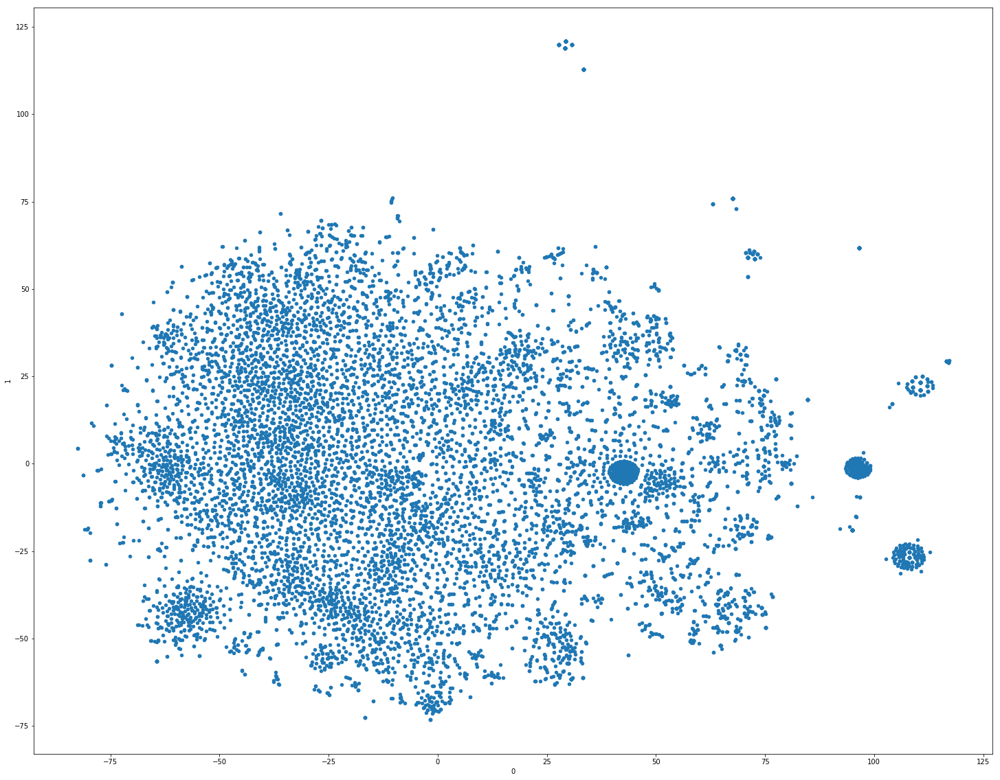

In [46]:
new_values_df.plot.scatter(x=0,y=1, figsize = (25,20))

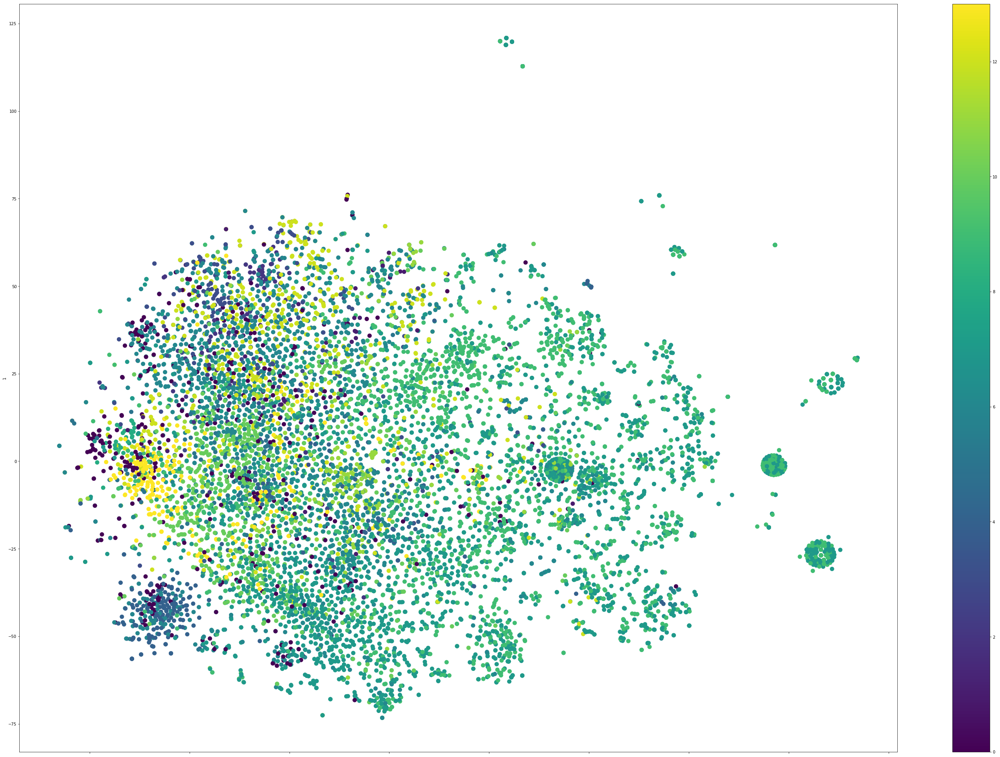

In [51]:
new_values_df.plot.scatter(x=0,y=1, figsize = (50,35),c=y_test, s=100,cmap='viridis')

In [10]:
import keras
from keras.models import Sequential
from keras.layers import Dense,LSTM, Conv1D, MaxPooling1D, Dropout, GlobalMaxPooling1D, Activation,Conv2D, MaxPooling2D, Flatten
from keras.layers.embeddings import Embedding
from keras.preprocessing import sequence
from keras.optimizers import RMSprop
from keras.layers.advanced_activations import LeakyReLU, PReLU


In [55]:
feature_array

array([[-0.51291382, -0.21465087,  0.81688628, ..., -0.34296391,
        -0.30000795, -0.3520113 ],
       [ 0.56702259, -0.02383902, -0.31372373, ..., -0.89984882,
         0.03790009, -1.12807592],
       [ 0.48287243, -0.15990552, -0.47768748, ..., -0.01046941,
        -0.17061663,  0.22300859],
       ...,
       [ 1.60882103,  3.38265753, -0.92065728, ...,  2.39629817,
         0.07794577,  0.30085409],
       [-0.74735137, -0.6307158 ,  1.23701377, ..., -0.17522661,
         0.00818312, -1.32727638],
       [-2.24920148,  0.61341392,  2.60800406, ..., -0.90842137,
        -2.66738355,  0.21290374]])

In [59]:
w2v_model = model

In [76]:
feature_array_y_test = y_test

In [149]:
wpt = nltk.WordPunctTokenizer()
tokenized_corpus_viz = [wpt.tokenize(str(document)) for document in df_train.content]
feature_array = averaged_word_vectorizer(tokenized_corpus_viz,w2v_model,100)
feature_array_y_test = df_train.big_tags

/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:9: DeprecationWarning: Call to deprecated `__getitem__` (Method will be removed in 4.0.0, use self.wv.__getitem__() instead).
  if __name__ == '__main__':


In [158]:
max_features = len(feature_array)*2
maxlen = 100
batch_size = 128
embedding_dims = 100
filters = 250
kernel_size = 3
hidden_dims = 250
epochs = 25
num_classes = 14

x_train, x_test, y_train, y_test = train_test_split(feature_array + 10, feature_array_y_test, test_size=0.2, random_state=42)

print('Pad sequences (samples x time)')
#x_train = sequence.pad_sequences(x_train, maxlen=maxlen)
#x_test = sequence.pad_sequences(x_test, maxlen=maxlen)

x_train = x_train.astype('float32')
x_test = x_test.astype('float32')

print('x_train shape:', x_train.shape)
print('x_test shape:', x_test.shape)

y_test = keras.utils.to_categorical(y_test, num_classes)
y_train = keras.utils.to_categorical(y_train, num_classes)

model = Sequential()
#model.add(Dense(512, input_shape=(maxlen,)))
model.add(Embedding(max_features+1,
                    embedding_dims,
                    input_length=maxlen))
model.add(Dropout(0.2))

model.add(Conv1D(filters,
                 kernel_size,
                 padding='valid',
                 activation='relu',
                 strides=1))
# we use max pooling:
model.add(MaxPooling1D(pool_size=2))
model.add(LSTM(128, input_shape=(max_features,maxlen)))

# We add a vanilla hidden layer:
#model.add(Dense(hidden_dims))
model.add(Dropout(0.2))
model.add(Activation('relu'))

# We project onto a single unit output layer, and squash it with a sigmoid:
model.add(Dense(1))
model.add(Dense(num_classes, activation='softmax'))

model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
model.fit(x_train, y_train,
          verbose=1,
          batch_size=batch_size,
          epochs=epochs,
         validation_data=(x_test, y_test))

Pad sequences (samples x time)
x_train shape: (155835, 100)
x_test shape: (38959, 100)
Train on 155835 samples, validate on 38959 samples
Epoch 1/25
155835/155835 [==============================] - 1295s 8ms/step - loss: 2.0630 - acc: 0.2588 - val_loss: 1.8252 - val_acc: 0.2600
Epoch 2/25
155835/155835 [==============================] - 1286s 8ms/step - loss: 1.7545 - acc: 0.3497 - val_loss: 1.7141 - val_acc: 0.3702
Epoch 3/25
155835/155835 [==============================] - 1285s 8ms/step - loss: 1.6932 - acc: 0.3744 - val_loss: 1.6786 - val_acc: 0.3770
Epoch 4/25
155835/155835 [==============================] - 1286s 8ms/step - loss: 1.6636 - acc: 0.3798 - val_loss: 1.6584 - val_acc: 0.3795
Epoch 5/25
155835/155835 [==============================] - 1285s 8ms/step - loss: 1.6461 - acc: 0.3827 - val_loss: 1.6485 - val_acc: 0.3799
Epoch 6/25
155835/155835 [==============================] - 1285s 8ms/step - loss: 1.6353 - acc: 0.3857 - val_loss: 1.6435 - val_acc: 0.3855
Epoch 7/25
15583

In [209]:
pred = model.predict_classes(x_test)

In [191]:
from sklearn.metrics import f1_score, roc_auc_score

In [213]:
print(f1_score(y_test, pred1, average='micro'))
print(roc_auc_score(y_test, pred1))

0.39962524705459584
0.5534323562238875


mass = []
for i in range(len(pred)):
    tmp = []
    tmp.append(pred.loc[i].idxmax())
    tmp.append(pred.drop(tmp, axis=1).loc[i].idxmax())
    tmp.append(pred.drop(tmp, axis=1).loc[i].idxmax())
    mass.append(tmp)
    print(i)
y_test1 = []
y_test = pd.DataFrame(y_test)
for i in range(len(y_test)):
    y_test1.append(y_test.loc[i].idxmax())
    print(i)
t_f = []
for i in range(len(y_test1)):
    if y_test1[i] in mass[i]:
        t_f.append(1)
    else:
        t_f.append(0)
    print(i)

Точность при выделении двух тегов 85%.
----

In [35]:
sum(t_f)/len(t_f)

0.8538461538461538

feature_array_2d = []
vocabulary = set(w2v_model.wv.index2word)
k=0
for i in tokenized_corpus_viz:
    tmp = []
    for j in i:
        if j in vocabulary:
            tmp.append(w2v_model[j])
    print(k)
    k+=1
    feature_array_2d.append(tmp)

In [264]:
np.save('feature_2d_1',np.array(feature_array_2d))

In [6]:
feature_array_2d = np.load('feature_2d_1.npy')

In [13]:
max_features = len(feature_array_2d)
maxlen = 100
batch_size = 128
embedding_dims = 100
filters = 250
kernel_size = 3
hidden_dims = 250
epochs = 25
num_classes = 14


'''X = feature_array_2d[:100000]
Y = feature_array_y_test[:100000]

x_train, x_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

x_train = sequence.pad_sequences(np.array(x_train), maxlen=100)
x_test = sequence.pad_sequences(np.array(x_test), maxlen=100)

y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)
'''

#x_train = x_train.reshape(80000,100,100)
#x_test = x_test.reshape(20000,100,100)

print('x_train shape:', x_train.shape)
print(x_train.shape[0], 'train samples')
print(x_test.shape[0], 'test samples')

input_shape = (100,100,1)
x_train = x_train.reshape(80000,100,100,1)
x_test = x_test.reshape(20000,100,100,1)

model = Sequential()
model.add(Conv2D(32, kernel_size=(3, 3),
                 activation=PReLU(),
                 input_shape=input_shape))
model.add(Conv2D(64, (3, 3), activation=PReLU()))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))
model.add(Flatten())
model.add(Dense(128, activation=PReLU()))
model.add(Dropout(0.5))
model.add(Dense(num_classes, activation='softmax'))

model.compile(loss=keras.losses.categorical_crossentropy,
              optimizer='adam',
              metrics=['accuracy'])

model.fit(x_train, y_train,
          batch_size=batch_size,
          epochs=epochs,
          verbose=1,
          validation_data=(x_test, y_test))
score = model.evaluate(x_test, y_test, verbose=0)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

x_train shape: (80000, 100, 100, 1)
80000 train samples
20000 test samples


/home/but/.local/lib/python3.5/site-packages/keras/activations.py:115: UserWarning: Do not pass a layer instance (such as PReLU) as the activation argument of another layer. Instead, advanced activation layers should be used just like any other layer in a model.
  identifier=identifier.__class__.__name__))


Train on 80000 samples, validate on 20000 samples
Epoch 1/25
80000/80000 [==============================] - 4737s 59ms/step - loss: 9.2199 - acc: 0.4254 - val_loss: 8.9351 - val_acc: 0.4435
Epoch 2/25
80000/80000 [==============================] - 4683s 59ms/step - loss: 9.0220 - acc: 0.4379 - val_loss: 8.9351 - val_acc: 0.4435
Epoch 3/25
80000/80000 [==============================] - 5065s 63ms/step - loss: 9.0095 - acc: 0.4388 - val_loss: 8.9352 - val_acc: 0.4435
Epoch 4/25
80000/80000 [==============================] - 5024s 63ms/step - loss: 9.0077 - acc: 0.4388 - val_loss: 8.9352 - val_acc: 0.4435
Epoch 5/25
80000/80000 [==============================] - 9389s 117ms/step - loss: 9.0112 - acc: 0.4386 - val_loss: 8.9351 - val_acc: 0.4435
Epoch 6/25
80000/80000 [==============================] - 5050s 63ms/step - loss: 9.0398 - acc: 0.4369 - val_loss: 8.9351 - val_acc: 0.4435
Epoch 7/25
80000/80000 [==============================] - 5058s 63ms/step - loss: 9.0327 - acc: 0.4373 - val_

KeyboardInterrupt: 

In [16]:
score = model.evaluate(x_test, y_test, verbose=1)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

20000/20000 [==============================] - 404s 20ms/step
Test loss: 8.935089682006836
Test accuracy: 0.44345


In [17]:
pred_2d = model.predict(x_test,verbose=1)

20000/20000 [==============================] - 411s 21ms/step


Двумерная сетка показала себя не очень. Исходя из кросс валидации, за 14 эпох она ни сколько не обучилась, и, скорее всего, большинство комментаариев относила к самому многочисленному классу без выявления истинной зависимости.

---------

# doc2vec teory

In [155]:
import pandas as pd
from gensim.models.phrases import Phraser, Phrases
from gensim.models.doc2vec import Doc2Vec
import nltk
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import keras
from keras.models import Sequential
from keras.layers import Dense,LSTM, Conv1D, MaxPooling1D, Dropout, GlobalMaxPooling1D, Activation,Conv2D, MaxPooling2D, Flatten
from keras.layers.embeddings import Embedding
from keras.preprocessing import sequence
from keras.optimizers import RMSprop
from keras.layers.advanced_activations import LeakyReLU, PReLU
from sklearn.preprocessing import LabelEncoder
from collections import namedtuple
from sklearn.manifold import TSNE


%matplotlib inline




df_train = pd.read_csv('df_with_tags.csv')
df_train = df_train[df_train.is_ru][df_train.as_tag]

wpt = nltk.WordPunctTokenizer()
tokenized_corpus_viz = [wpt.tokenize(str(document)) for document in df_train.content]
#feature_array = averaged_word_vectorizer(tokenized_corpus_viz,w2v_model,100)
feature_array_y_test = df_train.big_tags

le = LabelEncoder()
le.fit(df_train.big_tags[df_train.is_ru][df_train.as_tag])
df_train = df_train[df_train.is_ru][df_train.as_tag]
df_train.big_tags = le.transform(df_train.big_tags)
#df_train




feature_array_y_test = df_train.big_tags
#feature_array_2d = np.load('feature_2d_1.npy')




/home/but/.local/lib/python3.5/site-packages/ipykernel_launcher.py:26: UserWarning: Boolean Series key will be reindexed to match DataFrame index.


In [31]:
d2v_model = Doc2Vec( size=300, window=10, min_count=1, workers=4)

/home/but/.local/lib/python3.5/site-packages/gensim/models/doc2vec.py:366: UserWarning: The parameter `size` is deprecated, will be removed in 4.0.0, use `vector_size` instead.
  warnings.warn("The parameter `size` is deprecated, will be removed in 4.0.0, use `vector_size` instead.")


In [156]:
bigram = Phrases(tokenized_corpus_viz)
bigram_transformer = Phraser(bigram)

In [157]:
def tex_gen_bigram(tokenized_corpus = tokenized_corpus_viz):
    bigr = []
    for text in tokenized_corpus:
        bigr.append(bigram_transformer[[word for word in text]])
        #print(bigram_transform)
    return bigr

In [64]:
bigram_corp = tex_gen_bigram()
#bigram_transformer = Phraser(tokenized_corpus[0])

In [158]:
trigram = Phrases(bigram_corp)
trigram_trasformer = Phraser(trigram)
def tex_gen_trigram(tokenized_corpus = tokenized_corpus_viz):
    trig = []
    for text in tokenized_corpus:
        trig.append(trigram_trasformer[bigram_transformer[[word for word in text]]])
    return trig

In [66]:
trigram_corp = tex_gen_trigram()

In [67]:
docs = []
analyzedDocument = namedtuple('AnalyzedDocument', 'words tags')
for i, text in enumerate(trigram_corp):
    tags = [i]
    docs.append(analyzedDocument(text, tags))

In [37]:
d2v_model.build_vocab(docs)

In [38]:
d2v_model.train(docs, total_examples=model.corpus_count, epochs = 40)
d2v_model.save('d2v_model')

In [57]:
d2v_model = Doc2Vec.load('d2v_model')

--------------------
Проверим как наш док2век находит похожие комментарии

In [90]:
print(df_train.content.loc[29])
print('----------------------------------------------')
for i in d2v_model.docvecs.most_similar([d2v_model.infer_vector(docs[29].words)]):
    try:
        print(df_train.content.loc[i[0]])
        print()
        print()
    except:
        1+1

УЖАСНАЯ ОПТИМИЗАЦИЯ УЖАСНО ТОРМОЗИТ ВАШЕ ПРИЛОЖЕНИЕ ДАЖЕ НА IPHONE 8 PLUS. И СДЕЛАЙТЕ ПОЖАЛУЙСТА ПЕРЕВОРОТ ЭКРАНА В ГОРИЗОНТАЛЬНОЕ ПОЛОЖЕНИЕ , А ПОКА ОЦЕНКА 2 (((
----------------------------------------------
ОЧЕНЬ ПЛОХО СТАЛО ПРЯМО БОЛЬНО ПОЛЬЗОВАТЬСЯ С ТЕЛЕФОНА. НО АЛЬТЕРНАТИВ НА МОБИЛЬНОМ ВСЁ РАВНО НЕТ. НЕ ПОНРАВИЛОСЬ: ПЛОХАЯ РАБОТА ПРИ СЛАБОМ ПОДКЛЮЧЕНИИ, ДВОЙНОЕ СРАБАТЫВАНИЕ КНОПКИ НАЗАД, ОТ ЧЕГО ПОИСК СБРАСЫВАЕТСЯ. ПРИ ЛИСТАНИИ ОТЗЫВОВ СВОРАЧИВАНИЕ ОТЗЫВА СРАБАТЫВАЕТ ВМЕСТО ПРОЛИСТЫВАНИЯ. И ТАКОГО ПОЛНО. ПОЛЬЗОВАТЬСЯ С ТЕЛЕФОНА НЕВОЗМОЖНО, ПЕРЕШЁЛ НА ДЕСКТОП.


 КОГДА БУДЕТ ОБНОВЛЕННЯ ?? АЛСА МЕНЯ НЕ ПОНИМАЕТ ЧТО Я ГОВОРЮ. НЕ ПЛОХО КАК БИ ОНА ЧИТАЛА МОИ ОСТАЛЬНИ СМС ОТКРИВАЛА КАРТУ, КАК ЕЕ ПОПРОСИТЬ, ТАК ДАЛЕ. ЧТОБИ ОНА ПОМАГАЛА МОМУ ТЕЛЕФОНЕ. ЕТО БИ БУЛО СУПЕР)))) СЕЧАС Я СТАВЛЮ 2 ЗВЕЗДИ, А ЯК ЗРОБИТЕ ОНОВЛЕННЯ, ЯК Я ПРОШУ ВАС, ТО ПОСЛЕ Я ПОСТАВЛЮ 5+ А СЕЧАС ИЗВИНИТЕ


РЕКЛАМА ВАШЕГО БРАУЗЕРА ЗАДОЛБАЛА! ШЛАК!


РАНЬШЕ БЫЛО ОТЛИЧНОЕ ПРИЛОЖЕНИЕ! СЕЙЧАС ЖЕ НЕВОЗМОЖНО ПОЛЬЗОВАТЬСЯ 

In [6]:
tsne_mas = []
for i in range(len(tokenized_corpus_viz)):
    tsne_mas.append(d2v_model[i])

In [10]:
def tsne_plot_comment_3d(feature_array):
    
    tsne_model = TSNE(perplexity=40, n_components=3, init='pca', n_iter=2500, random_state=23, verbose=1)
    new_values = tsne_model.fit_transform(feature_array)
    
    return new_values

In [8]:
x_train, x_test, y_train, y_test = train_test_split(tsne_mas, df_train.big_tags, test_size=0.1, random_state=42)

-----
Схлопнем 300 мерные вектора до 3х мерных

In [12]:
new_value_3d = tsne_plot_comment_3d(x_test)

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 19480 samples in 0.635s...
[t-SNE] Computed neighbors for 19480 samples in 364.121s...
[t-SNE] Computed conditional probabilities for sample 1000 / 19480
[t-SNE] Computed conditional probabilities for sample 2000 / 19480
[t-SNE] Computed conditional probabilities for sample 3000 / 19480
[t-SNE] Computed conditional probabilities for sample 4000 / 19480
[t-SNE] Computed conditional probabilities for sample 5000 / 19480
[t-SNE] Computed conditional probabilities for sample 6000 / 19480
[t-SNE] Computed conditional probabilities for sample 7000 / 19480
[t-SNE] Computed conditional probabilities for sample 8000 / 19480
[t-SNE] Computed conditional probabilities for sample 9000 / 19480
[t-SNE] Computed conditional probabilities for sample 10000 / 19480
[t-SNE] Computed conditional probabilities for sample 11000 / 19480
[t-SNE] Computed conditional probabilities for sample 12000 / 19480
[t-SNE] Computed conditional probabilities for 

In [13]:
pd.DataFrame(new_value_3d).to_csv('tsne_3d.csv', index=False)

In [17]:
y_test.to_csv('tsne_3d_color.csv')
pd.DataFrame(x_test).to_csv('tsne_3d_color_val.csv')
#y_test.to_csv('tsne_3d_color.csv')

In [23]:
d2v_model.wv[d2v_model.wv.index2entity]

array([[-1.9214250e+00,  6.2545568e-01, -7.5217158e-01, ...,
         3.2309272e+00, -6.2330830e-01,  1.0896566e+00],
       [-1.9689020e+00,  6.6400278e-01, -7.5781149e-01, ...,
         3.3681934e+00, -6.8614966e-01,  1.1154531e+00],
       [-1.8276516e+00,  5.7028759e-01, -7.4509364e-01, ...,
         2.9498544e+00, -5.5695724e-01,  1.0599254e+00],
       ...,
       [ 1.0746229e-03,  1.6559333e-03, -1.1862377e-03, ...,
        -5.2705116e-05, -8.1414124e-04, -1.5362615e-03],
       [ 3.5721497e-04,  5.4965367e-05,  1.3444263e-04, ...,
        -5.1711022e-04,  1.3381017e-03,  1.2169592e-03],
       [-1.6921470e-03, -1.4474420e-03, -1.5673249e-03, ...,
        -1.6131530e-04, -7.0126943e-04,  1.0898768e-04]], dtype=float32)

In [30]:
pd.DataFrame(tsne_mas).to_csv('x_test_train.csv', index = False)

In [2]:
tsne_mas = pd.read_csv('x_test_train.csv')

-----
построим 3х мерное распределение для каждого класса

/home/but/.local/lib/python3.5/site-packages/matplotlib/font_manager.py:1328: UserWarning: findfont: Font family ['normal'] not found. Falling back to DejaVu Sans
  (prop.get_family(), self.defaultFamily[fontext]))


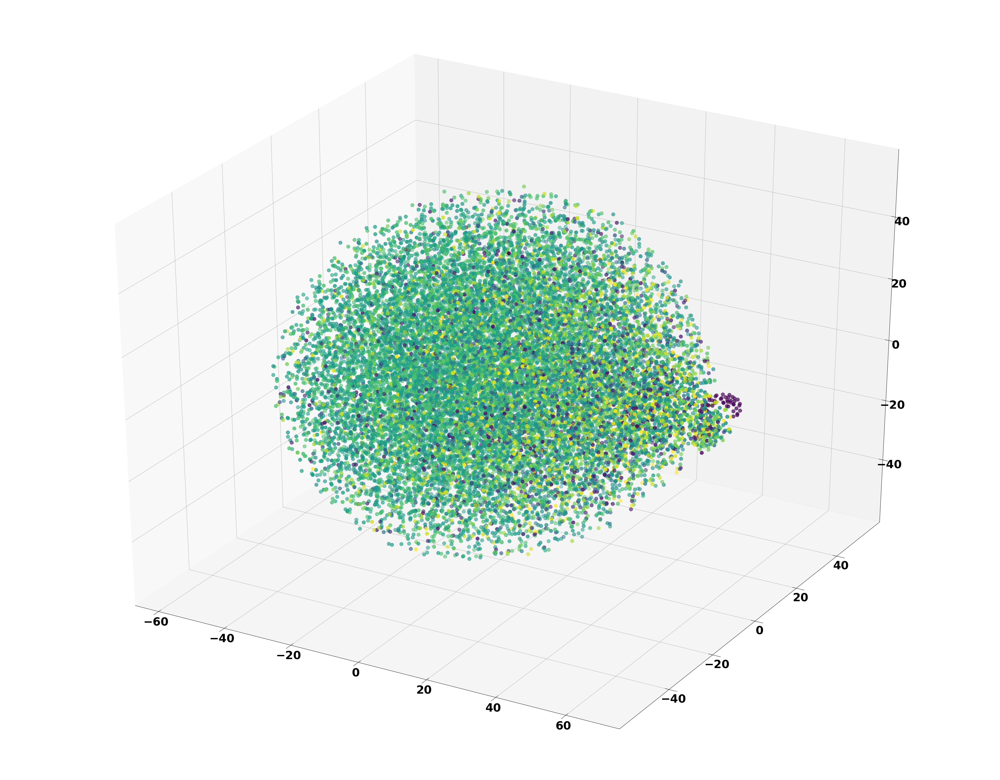

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


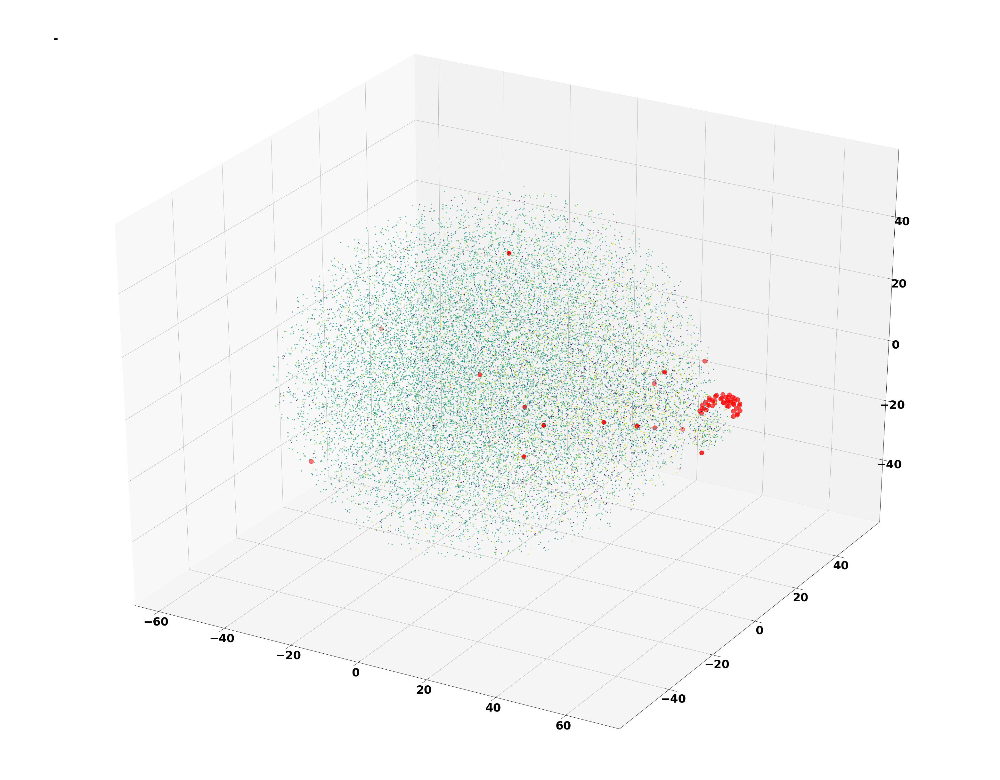

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


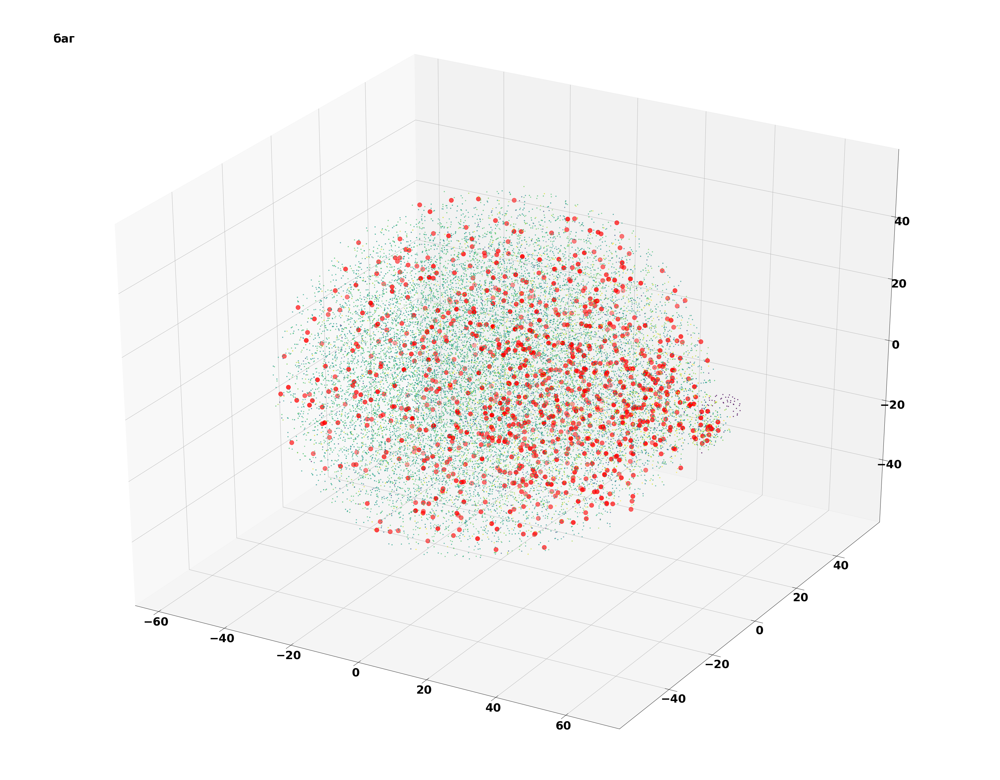

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


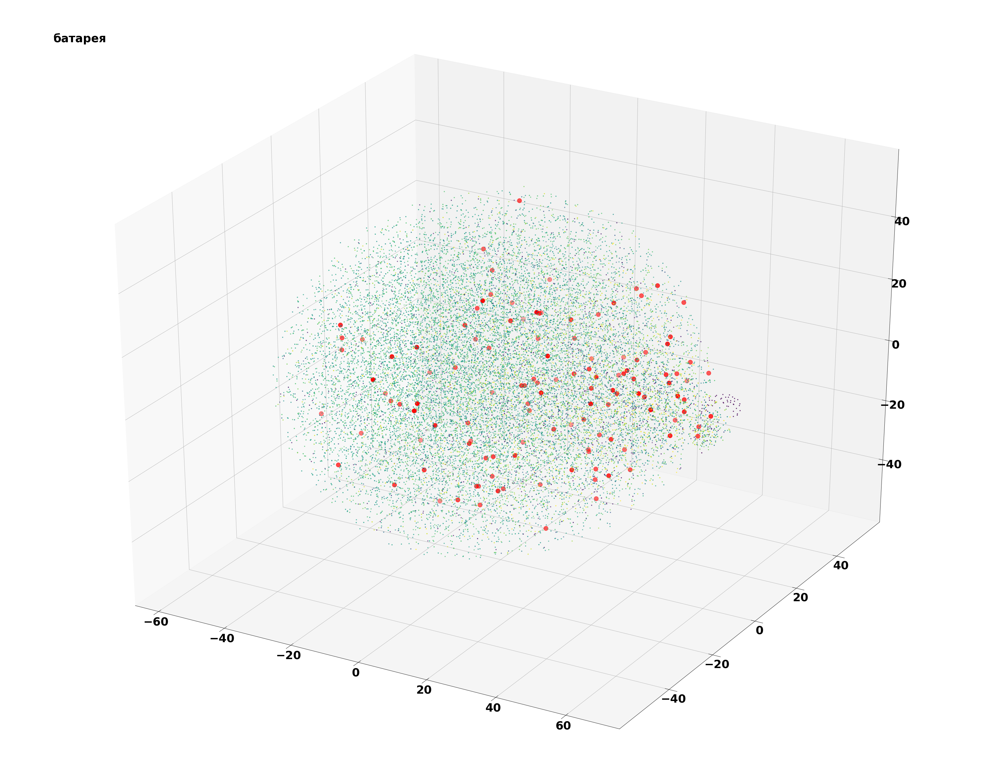

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


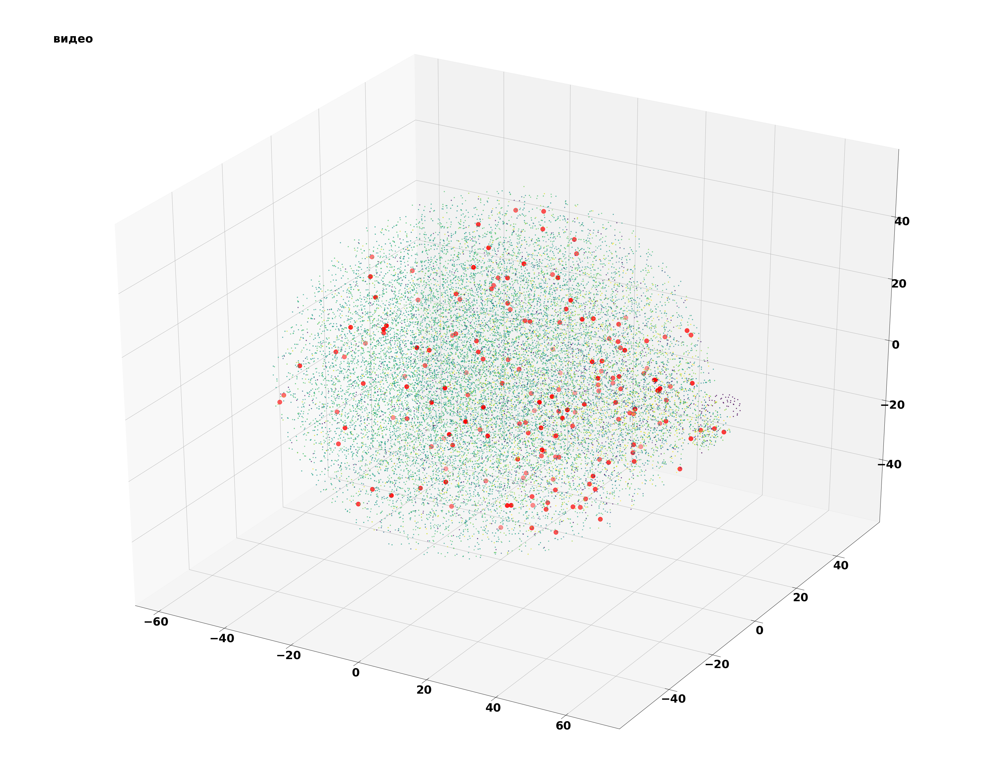

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


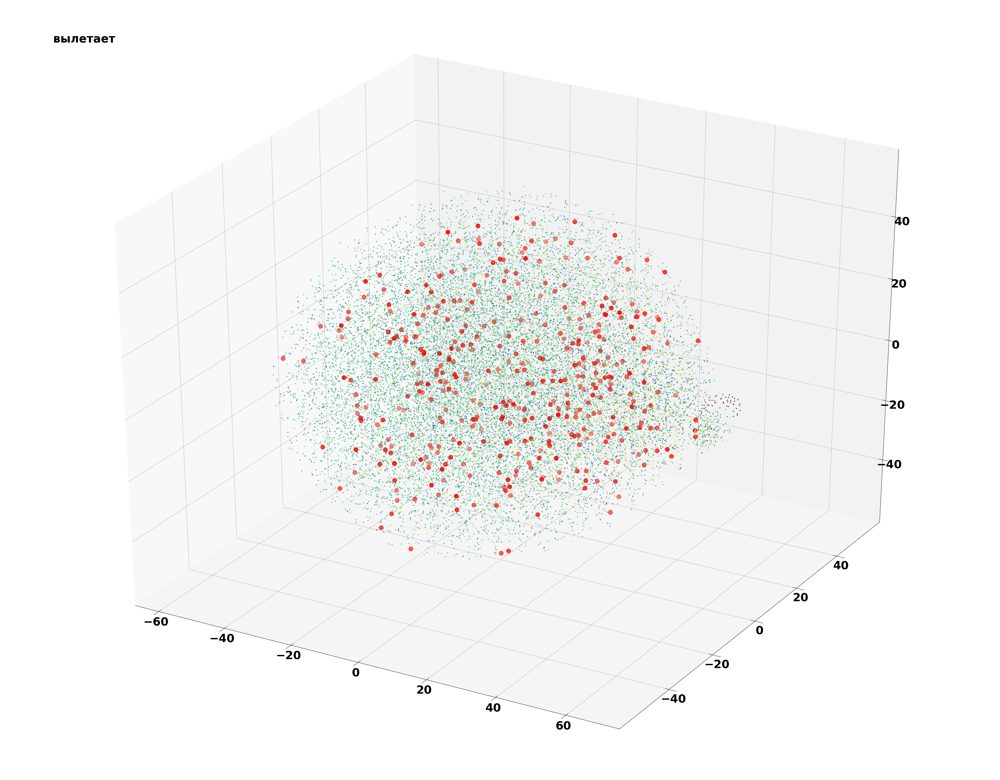

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


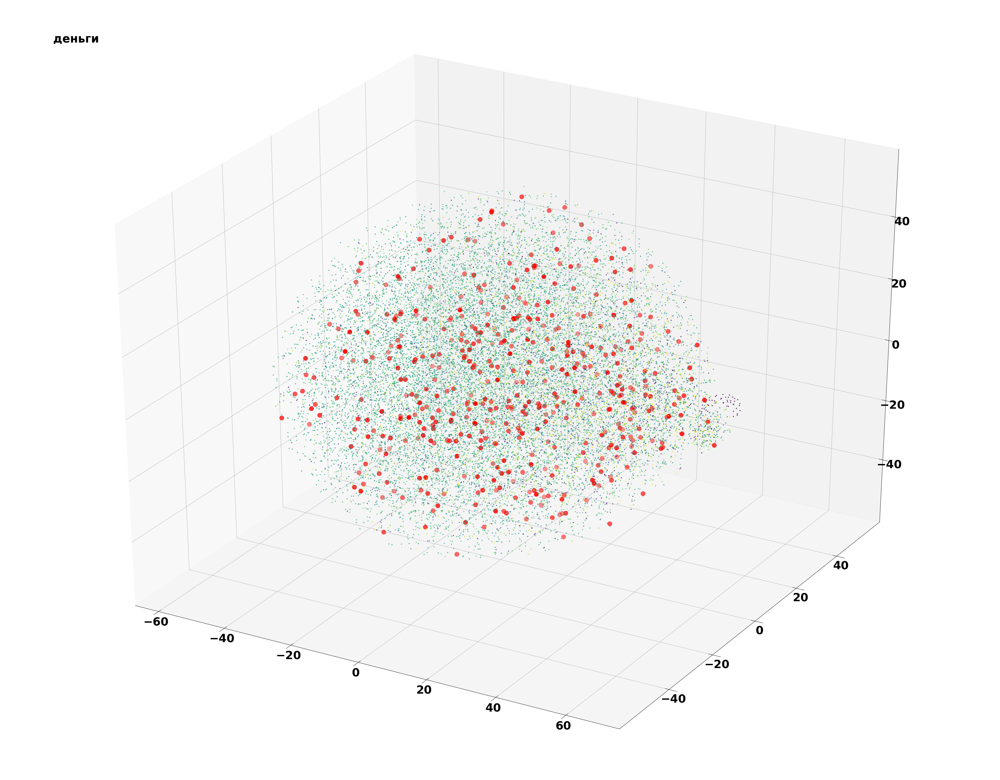

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


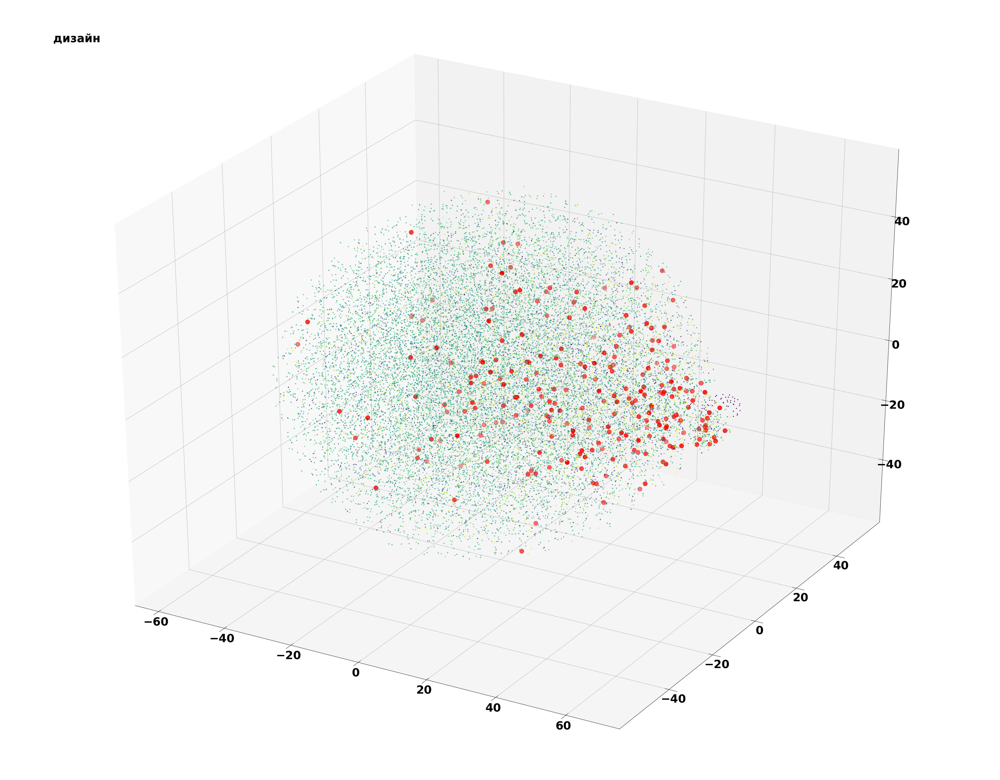

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


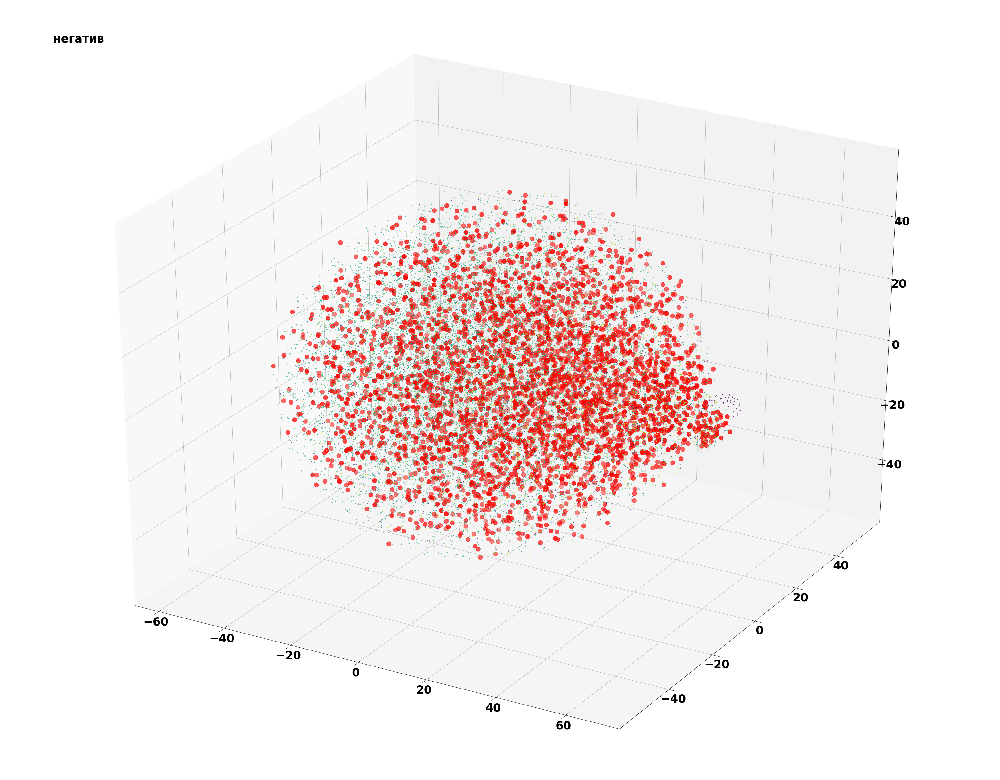

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


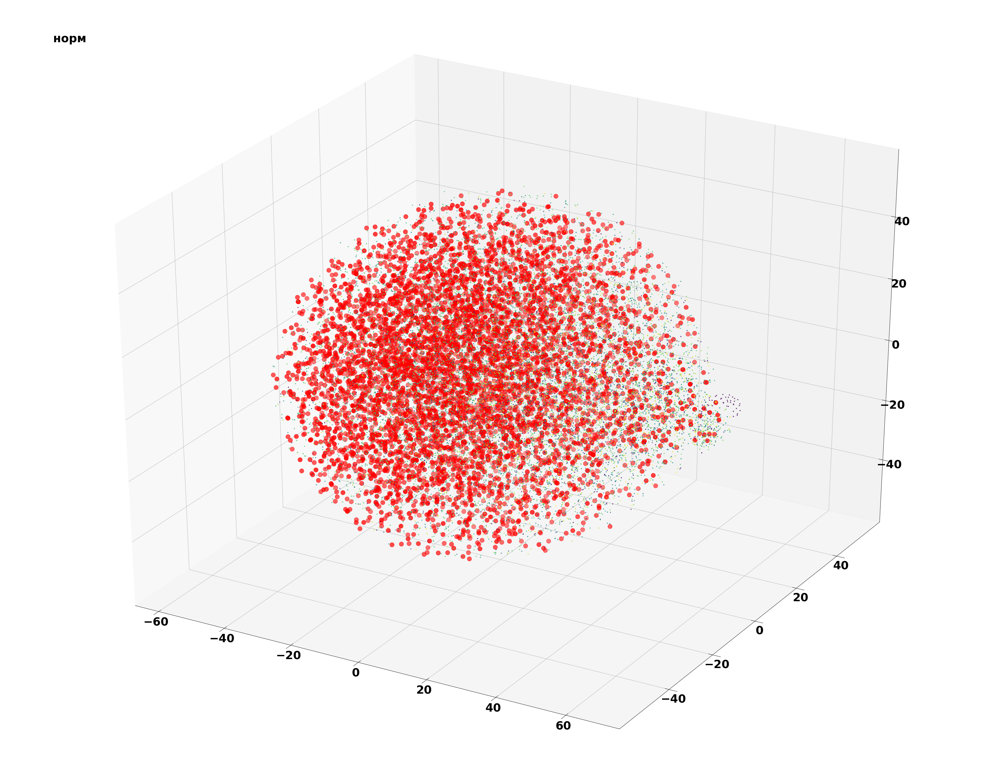

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


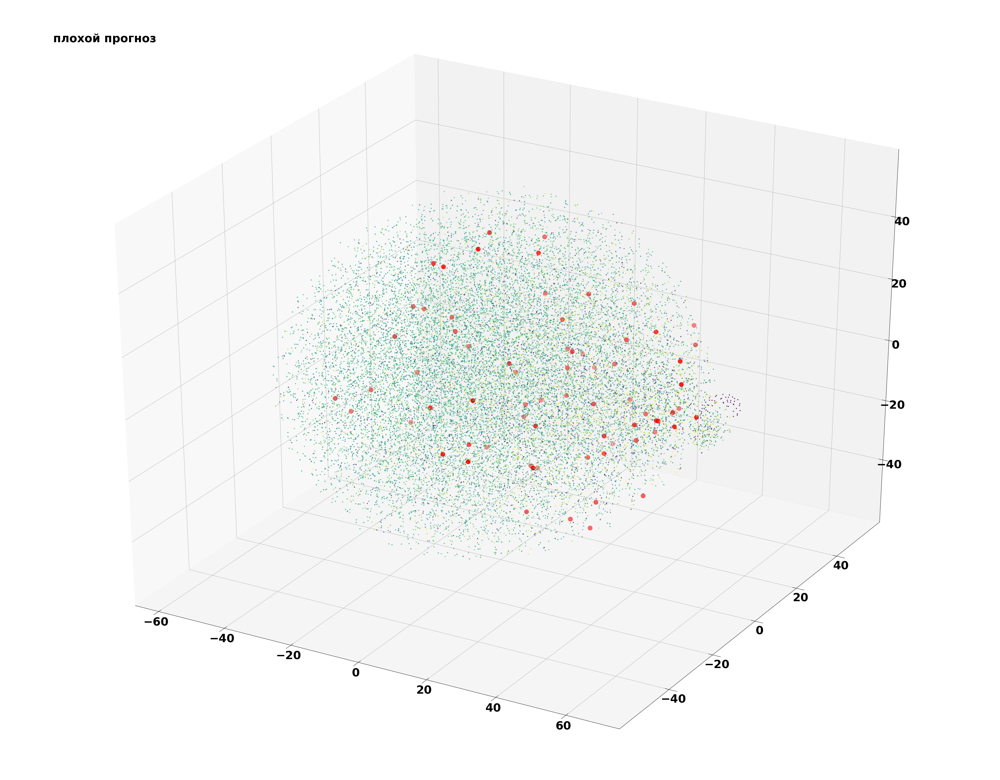

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


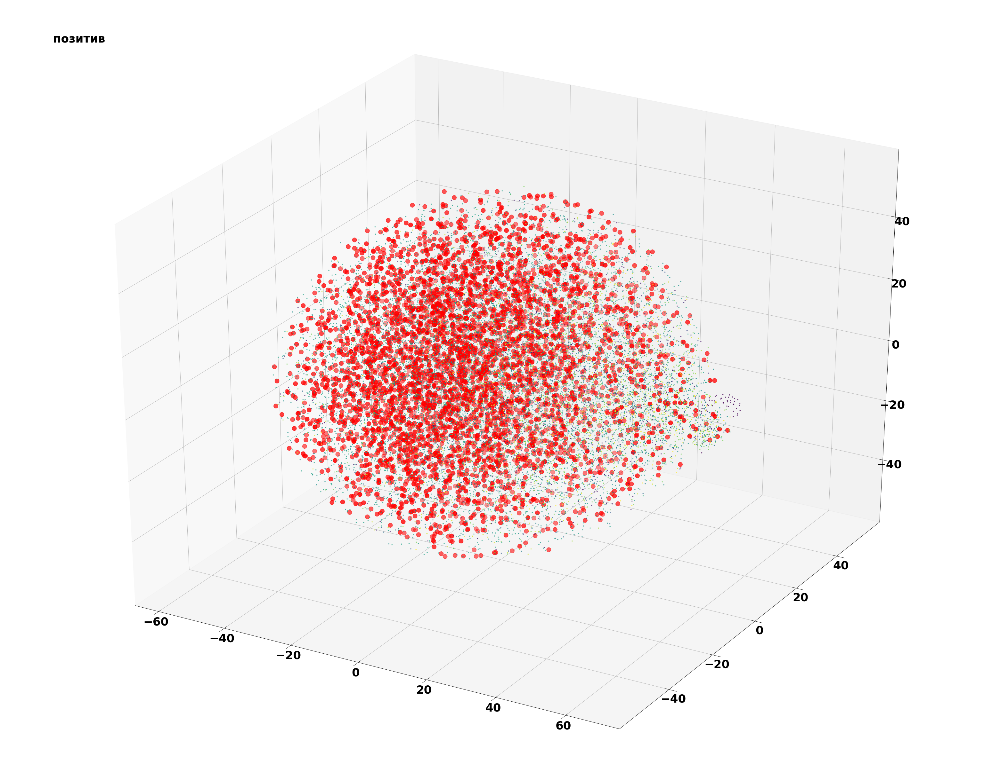

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


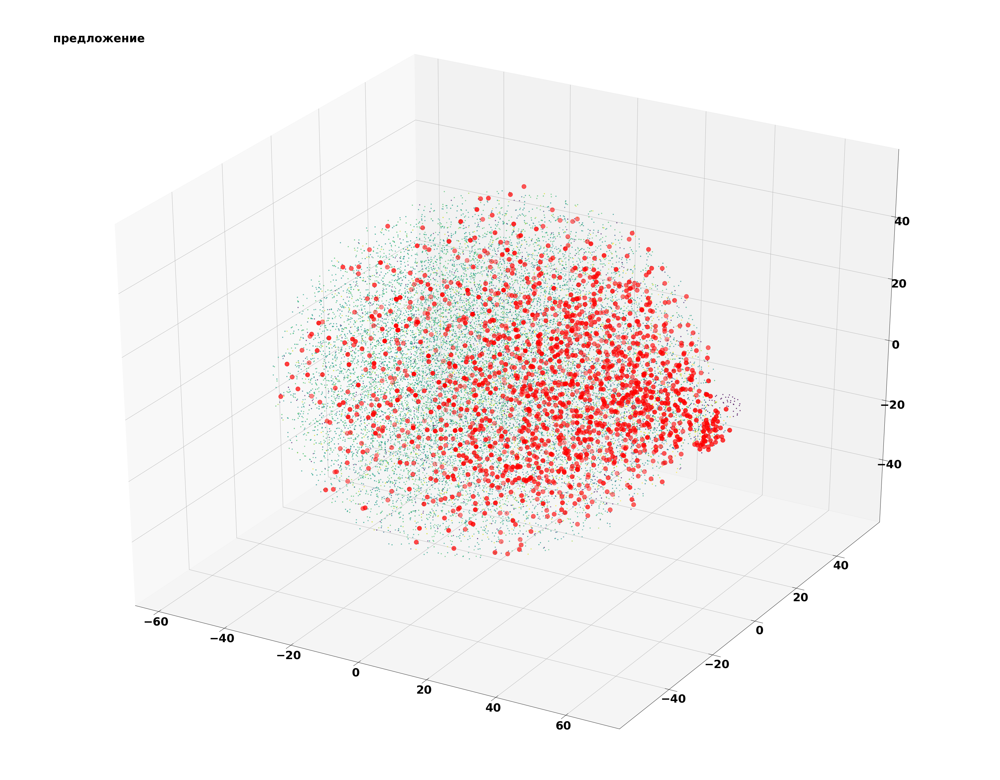

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


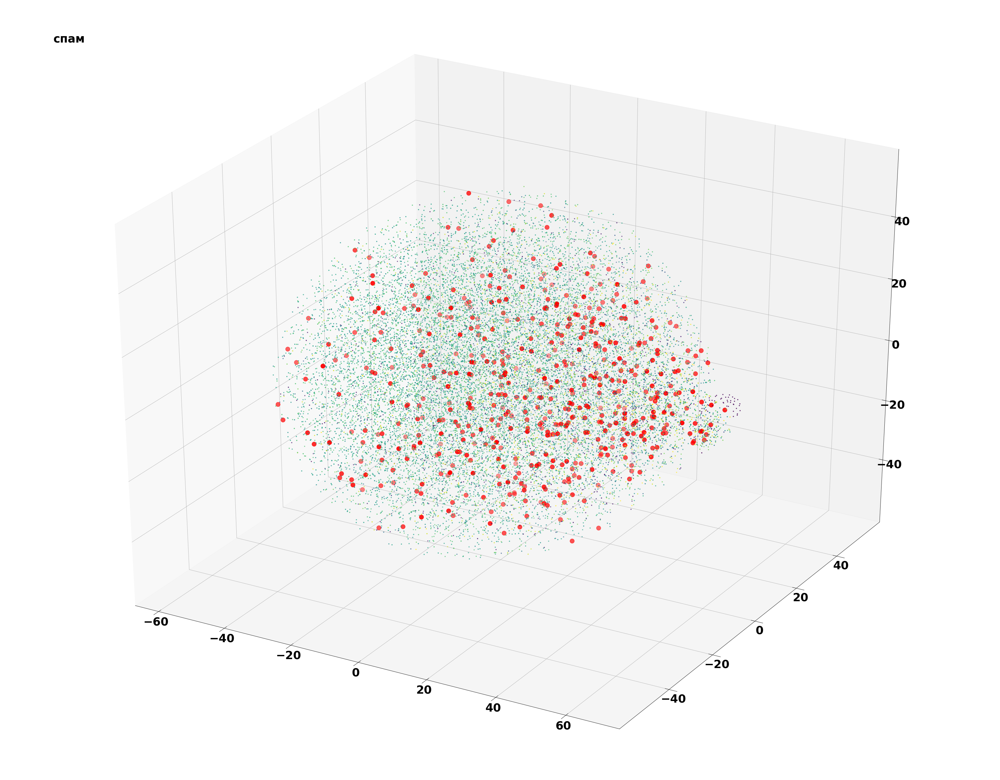

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


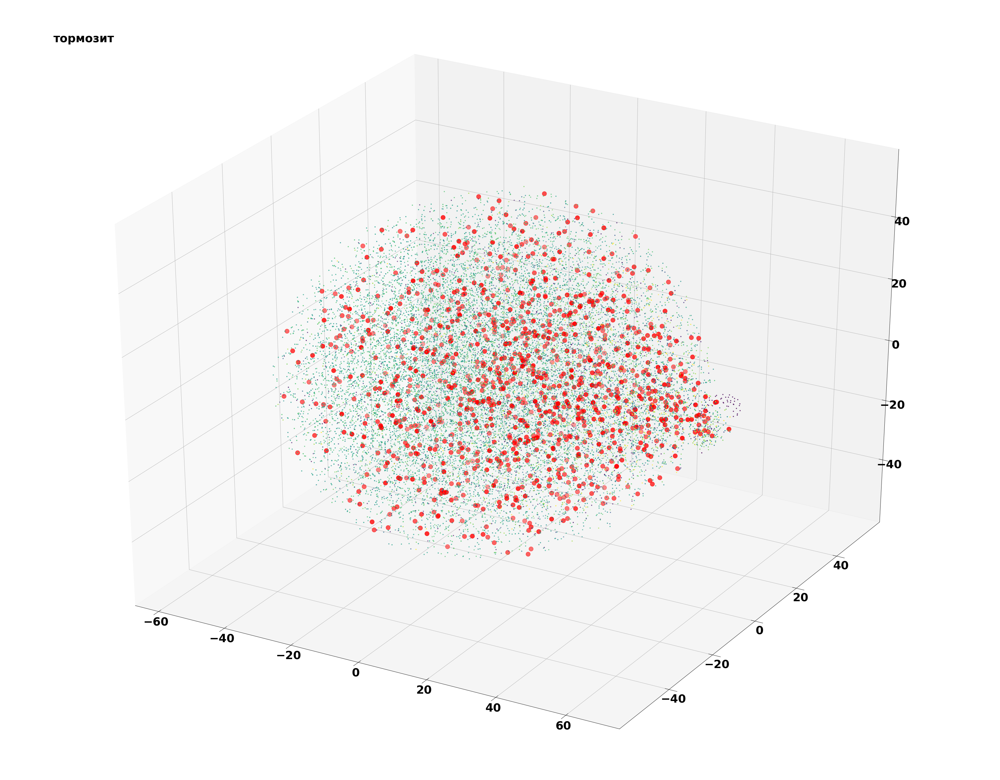

/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


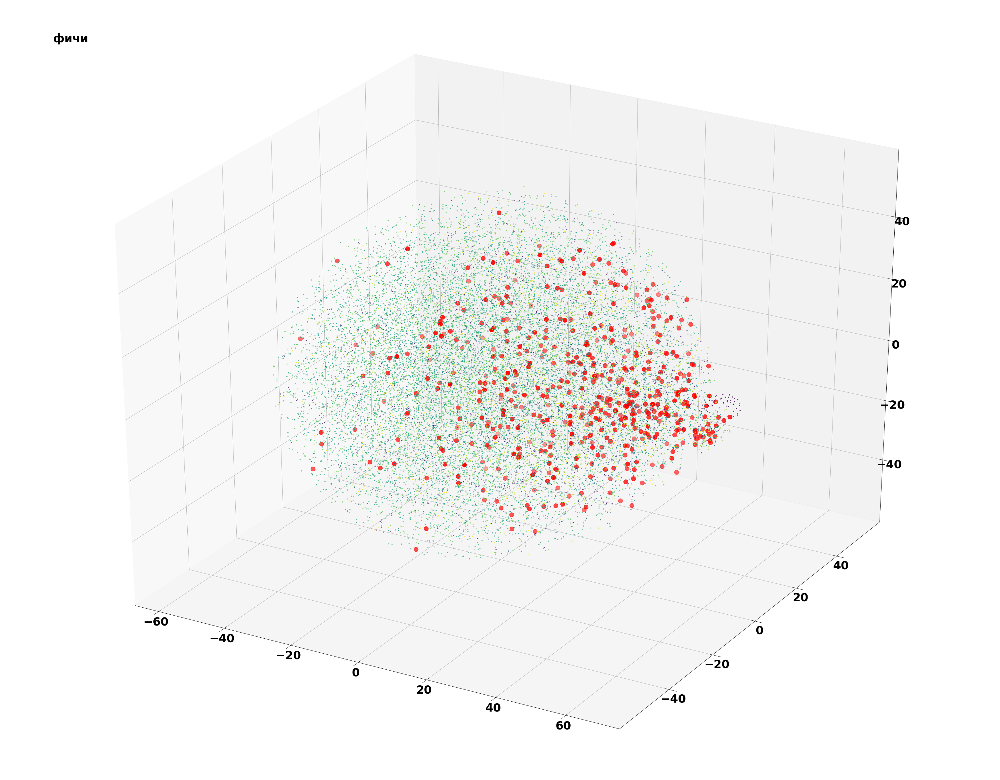

CPU times: user 2min 14s, sys: 3.99 s, total: 2min 18s
Wall time: 2min 14s


In [175]:
%%time
from mpl_toolkits.mplot3d import Axes3D

font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 32}

plt.rc('font', **font)


df = pd.read_csv('tsne_3d.csv')
color = pd.read_csv('tsne_3d_color.csv')
threedee = plt.figure(figsize=(50,40),num=None,  dpi=80, facecolor='w', edgecolor='k').gca(projection='3d')
threedee.scatter(df['0'], df['1'], df['2'],c=color.col.as_matrix(), s=100)
#plt.figure(figsize=(50,40),num=None,  dpi=80, facecolor='w', edgecolor='k')
#fig = threedee.get_figure()
#fig.savefig("output.png")

plt.show()
for i in range(15):
    fig = plt.figure(figsize=(50,40),num=None, dpi=80, facecolor='w', edgecolor='k')
    ax = fig.gca(projection='3d')
    ax.scatter(df['0'][color.col == i], df['1'][color.col == i], df['2'][color.col == i],c='r', s=150)
    ax.scatter(df['0'][color.col != i], df['1'][color.col != i], df['2'][color.col != i],c=color.col[color.col != i].as_matrix(), s=5)
    ax.text2D(0.05, 0.95, le.inverse_transform(i), transform=ax.transAxes, )
    plt.show()

In [53]:
from sklearn.manifold import TSNE

In [10]:
max_features = len(tsne_mas)
maxlen = 300
batch_size = 128
embedding_dims = 100
filters = 250
kernel_size = 3
hidden_dims = 250
epochs = 25
num_classes = 15

x_train, x_test, y_train, y_test = train_test_split((tsne_mas + tsne_mas.min().min()*(-1))*10000, df_train.big_tags, test_size=0.2, random_state=42)

print('Pad sequences (samples x time)')
#x_train = sequence.pad_sequences(x_train, maxlen=maxlen)
#x_test = sequence.pad_sequences(x_test, maxlen=maxlen)

#x_train = x_train.astype('float32')
#x_test = x_test.astype('float32')

#print('x_train shape:', x_train.shape)
#print('x_test shape:', x_test.shape)

y_test = keras.utils.to_categorical(y_test, num_classes)
y_train = keras.utils.to_categorical(y_train, num_classes)

model = Sequential()
#model.add(Dense(512, input_shape=(maxlen,)))
model.add(Embedding(max_features+1,
                    embedding_dims,
                    input_length=maxlen))
model.add(Dropout(0.2))

model.add(Conv1D(filters,
                 kernel_size,
                 padding='valid',
                 activation='relu',
                 strides=1))
# we use max pooling:
model.add(MaxPooling1D(pool_size=2))
model.add(LSTM(128, input_shape=(max_features,maxlen)))

# We add a vanilla hidden layer:
#model.add(Dense(hidden_dims))
model.add(Dropout(0.2))
model.add(Activation('relu'))

# We project onto a single unit output layer, and squash it with a sigmoid:
model.add(Dense(1))
model.add(Dense(num_classes, activation='softmax'))

print('start compile')

model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
print('start fit')
model.fit(x_train, y_train,

          batch_size=batch_size,
          epochs=epochs,
         validation_data=(x_test, y_test))

Pad sequences (samples x time)
start compile
start fit
Train on 155835 samples, validate on 38959 samples
Epoch 1/25
155835/155835 [==============================] - 2472s 16ms/step - loss: 2.0400 - acc: 0.2788 - val_loss: 1.9305 - val_acc: 0.3050
Epoch 2/25
155835/155835 [==============================] - 2231s 14ms/step - loss: 1.9154 - acc: 0.3199 - val_loss: 1.9054 - val_acc: 0.3281
Epoch 3/25
155835/155835 [==============================] - 2189s 14ms/step - loss: 1.9021 - acc: 0.3283 - val_loss: 1.9014 - val_acc: 0.3304
Epoch 4/25
155835/155835 [==============================] - 2180s 14ms/step - loss: 1.8956 - acc: 0.3293 - val_loss: 1.8978 - val_acc: 0.3286
Epoch 5/25
155835/155835 [==============================] - 2194s 14ms/step - loss: 1.8931 - acc: 0.3293 - val_loss: 1.8961 - val_acc: 0.3307
Epoch 6/25
155835/155835 [==============================] - 2176s 14ms/step - loss: 1.8909 - acc: 0.3291 - val_loss: 1.8942 - val_acc: 0.3298
Epoch 7/25
155835/155835 [================

In [11]:
model.save('ready_model.h5')

In [161]:
pred = model.predict(x_test[:100], verbose=1)

100/100 [==============================] - 1s 6ms/step


pred = pd.DataFrame(pred)
mass = []
for i in range(len(pred)):
    tmp = []
    tmp.append(pred.loc[i].idxmax())
    tmp.append(pred.drop(tmp, axis=1).loc[i].idxmax())
    tmp.append(pred.drop(tmp, axis=1).loc[i].idxmax())
    mass.append(tmp)
    print(i)
y_test1 = []
y_test = pd.DataFrame(y_test)
for i in range(len(y_test)):
    y_test1.append(y_test.loc[i].idxmax())
    print(i)
t_f = []
for i in range(len(y_test1)):
    if y_test1[i] in mass[i]:
        t_f.append(1)
    else:
        t_f.append(0)
    print(i)

In [34]:
sum(t_f)/len(t_f)

0.6978105187504813

In [36]:
pred

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14
0,0.003203,0.083941,0.013141,0.015413,0.025884,0.026580,0.034227,0.270757,0.064804,0.007151,0.061362,0.192737,0.043540,0.083446,0.073812
1,0.000993,0.067341,0.008705,0.010948,0.027691,0.029181,0.014180,0.255348,0.180564,0.003541,0.153108,0.107874,0.035810,0.073611,0.031106
2,0.000055,0.019754,0.001828,0.002597,0.013422,0.014797,0.001313,0.099328,0.464955,0.000448,0.325195,0.016885,0.010971,0.025484,0.002968
3,0.000317,0.044603,0.004977,0.006604,0.022881,0.024597,0.005652,0.191514,0.311339,0.001619,0.242529,0.054182,0.024177,0.052447,0.012563
4,0.004665,0.084609,0.014264,0.016284,0.023341,0.023729,0.044550,0.256358,0.040352,0.008687,0.039876,0.223302,0.043465,0.081077,0.095440
5,0.000118,0.028574,0.002856,0.003946,0.017291,0.018866,0.002478,0.134624,0.407512,0.000786,0.297963,0.028232,0.015711,0.035481,0.005562
6,0.000954,0.066548,0.008553,0.010780,0.027601,0.029109,0.013739,0.253563,0.185199,0.003450,0.156521,0.105463,0.035415,0.072951,0.030154
7,0.000506,0.053735,0.006348,0.008250,0.025300,0.026987,0.008292,0.219863,0.258790,0.002252,0.208337,0.072669,0.028911,0.061421,0.018336
8,0.000169,0.033852,0.003518,0.004791,0.019323,0.020972,0.003357,0.154341,0.375002,0.001027,0.280403,0.035982,0.018520,0.041233,0.007509
9,0.000029,0.014145,0.001228,0.001786,0.010582,0.011768,0.000754,0.075079,0.504855,0.000273,0.340309,0.010720,0.007922,0.018837,0.001714


---
Вот так будет выглядеть скрипт для автоматизированной разметки.
---

при условии, что обученные модели doc2vec/word2vec, NN, skip-gram (bi-gram, tri-gram) уже загружены.  
3 комментария разметились за 2.71 сек. (без графической обочки скорость будет на 10-15% больше)


In [174]:
%%time
example_comments = ['ТУПИТ РАНЬШЕ ПРИЛОЖЕНИЕ НЕ ТУПО, СЕЙЧАС ИЩЕТ ТОВАР, А КОГДА НАЖИМАЮ НА НЕГО, ЧТОБЫ ОПИСАНИЕ ПРОЧИТАТЬ НЕ ПЕРЕХОДИТ . В ИТОГЕ ВСЕ ПРИЛОЖЕНИЕ НАЧИНАЕТ ВИСНУТЬ, ДАЖЕ ПОСЛЕ ОБНОВЛЕНИЯ ЭТО НЕ ИСЧЕЗЛО',
                   'УДОБНОЕ ПРИЛОЖЕНИЕ ПРИЛОЖЕНИЙ МНОГО, А УДОБНОЕ ТОЛЬКО ОДНО))). ИНТЕРЕСНО, БУДЕТ ЛИ ФУНКЦИЯ ПЕРЕВОДА СЛОВА ПРИ НАВЕДЕНИИ ПАЛЬЦЕМ НА СЛОВО В ДРУГОМ ПРИЛОЖЕНИИ? КОГДА ЧАСТО ПОЛЬЗУЕШЬСЯ ПРИЛОЖЕНИЕМ, ТО УСТАЁШЬ ОТ ОДНОТИПНЫХ ДЕЙСТВИЙ.',
                   ' ОТСТОЙ! ПРИЧИНЫ: 1-АЯ: РЕКЛАМА НА ВЕСЬ ЭКРАН В ВИРУСНЫХ ПРИЛОЖЕНИЯХ 2-АЯ: ГОЛИМЫЙ БОТ 3-ЯЯ: НЕ СКАЧИВАЮТСЯ ФОТОГРАФИИ 4-АЯ: НУДНЫЙ ИНТЕРФЕЙС']

wpt = nltk.WordPunctTokenizer()
tokenized_corpus_ex = [wpt.tokenize(str(document)) for document in example_comments]

'''this is object need save'''
#bigram = Phrases(tokenized_corpus_ex)
#bigram_transformer = Phraser(bigram)

bigram_corp_ex = tex_gen_bigram(tokenized_corpus=tokenized_corpus_ex)


'''this is object need save'''
#trigram = Phrases(bigram_corp)
#trigram_trasformer = Phraser(trigram)

trigram_corp_ex = tex_gen_trigram(tokenized_corpus=bigram_corp_ex)

trigram_corp_ex

docs = []
analyzedDocument = namedtuple('AnalyzedDocument', 'words tags')
for i, text in enumerate(trigram_corp_ex):
    tags = [i]
    docs.append(analyzedDocument(text, tags))

for i in docs:
    vec = (pd.DataFrame(d2v_model.infer_vector(i.words)).T + tsne_mas.min().min()*(-1)) * 10000
    pre = model.predict(vec)
    pre = pd.DataFrame(pre)
    tmp = []
    tmp.append(pre.loc[0].idxmax())
    tmp.append(pre.drop(tmp, axis=1).loc[0].idxmax())
    tmp.append(pre.drop(tmp, axis=1).loc[0].idxmax())
    print(example_comments[k])
    print()
    print(le.inverse_transform(tmp))
    print('--------------------------------------------------------------')
    k+=1

ТУПИТ РАНЬШЕ ПРИЛОЖЕНИЕ НЕ ТУПО, СЕЙЧАС ИЩЕТ ТОВАР, А КОГДА НАЖИМАЮ НА НЕГО, ЧТОБЫ ОПИСАНИЕ ПРОЧИТАТЬ НЕ ПЕРЕХОДИТ . В ИТОГЕ ВСЕ ПРИЛОЖЕНИЕ НАЧИНАЕТ ВИСНУТЬ, ДАЖЕ ПОСЛЕ ОБНОВЛЕНИЯ ЭТО НЕ ИСЧЕЗЛО

['негатив' 'предложение' 'тормозит']
--------------------------------------------------------------


/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


УДОБНОЕ ПРИЛОЖЕНИЕ ПРИЛОЖЕНИЙ МНОГО, А УДОБНОЕ ТОЛЬКО ОДНО))). ИНТЕРЕСНО, БУДЕТ ЛИ ФУНКЦИЯ ПЕРЕВОДА СЛОВА ПРИ НАВЕДЕНИИ ПАЛЬЦЕМ НА СЛОВО В ДРУГОМ ПРИЛОЖЕНИИ? КОГДА ЧАСТО ПОЛЬЗУЕШЬСЯ ПРИЛОЖЕНИЕМ, ТО УСТАЁШЬ ОТ ОДНОТИПНЫХ ДЕЙСТВИЙ.

['норм' 'позитив' 'негатив']
--------------------------------------------------------------


/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


 ОТСТОЙ! ПРИЧИНЫ: 1-АЯ: РЕКЛАМА НА ВЕСЬ ЭКРАН В ВИРУСНЫХ ПРИЛОЖЕНИЯХ 2-АЯ: ГОЛИМЫЙ БОТ 3-ЯЯ: НЕ СКАЧИВАЮТСЯ ФОТОГРАФИИ 4-АЯ: НУДНЫЙ ИНТЕРФЕЙС

['негатив' 'предложение' 'фичи']
--------------------------------------------------------------
CPU times: user 2.06 s, sys: 767 ms, total: 2.83 s
Wall time: 2.71 s


/home/but/.local/lib/python3.5/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


# ИТОГИ

- Качество при обучении одинаково простых нейронных сетей лучше при использовании среднего вектора комментария word2vec, чем вектора doc2vec
- При построении doc2vec учитывается не только каждное слово в отдельности, но и их расположение в предложении. При визуализации видно сильное пересечение тегов, и это не comme il faut.
- Как прототип результаты норм, но до запуска в работу ещё надо многое сделать. 
- bag of words + LinearModels + L1/L2/elastic regularization сработали совсем не очень. Необходим подбор гипер параметров. В этот ноутбук добавлять не стал, т.к. не информативно.

# ПРЕДЛОЖЕНИЯ

Исходя из вышеказанного, и не только, для улучшения качества и повышения стабильности необходимо:
---
- Очистка комментариев (построение словаря стоп слов для каждого тега в отдельности)
- Более качественные данные (например, то что я говорил по поводу тега 'dislike')
- Больший объём данных (Если больший объём нет возможности получить - отказатья от ИНС и перейти на градиентные бустинги)
- Увеличение числа эпох, до максимального схождения к минимуму функции потерь
- Создание моделий для каждого класса в отдельности (позитив/негатив/нейтрал, спам/неспам, баг/не баг, фича/ не фича и т.д.)

---
пока идей больше нет